In [1]:
%matplotlib inline

import sys
import datacube
import matplotlib.pyplot as plt
from datacube.utils.cog import write_cog

# sys.path.insert(1, '../Tools/')
from dea_tools.plotting import display_map
from dea_tools.plotting import rgb
from dea_tools.datahandling import load_ard

### Choose a study area


In [3]:
# Enter the bounding box for the study area (piura)
# study_area_lat = (-5.95, -5.45)
# study_area_lon = (-80.792, -80.292)

# Enter the bounding box for the study area (puerto maldonado)
study_area_lat = (-12.6642, -12.5218)
study_area_lon = (-69.2787, -69.1057)

# Enter the bounding box for the study area (manu park)
# study_area_lat = (-11.9942, -11.8518)
# study_area_lon = (-71.4287, -71.2557)

# Enter the bounding box for the study area (huascaran)
# study_area_lat = (-9.1942, -9.0518)
# study_area_lon = (-77.6787, -77.5057)

# Enter the bounding box for the study area (mina / urban)
# study_area_lat = (-12.9537, -13.0763)
# study_area_lon = (-70.6002, -70.4579)


In [4]:
# Display bounding box
display_map(x=study_area_lon, y=study_area_lat)

### Loading data

In [5]:
# Set the data source - Sentinel-2A and 2B COGS
set_product = ['s2_l2a']

# Set the date range to load data over
set_time = ("2020-01-01", "2020-12-31")

# Set maximum visibility (opposite of cloud coverage)
cloud = 0.85

# Set the measurements/bands to load
# blue, green, red, vegetation red edge1, NIR, SWIR1
set_measurements = ["B02", "B03", "B04", "B05", "B08", "B11"]

# Set the coordinate reference system and output resolution
set_crs = "EPSG:32718"
set_resolution = (-20, 20)

In [6]:
# load data
ds = load_ard(dc=dc,
    products=set_product,
    min_gooddata=cloud,
    x=study_area_lon,
    y=study_area_lat,
    time=set_time,
    measurements=set_measurements,
    output_crs=set_crs,
    resolution=set_resolution,
)
ds

Using pixel quality parameters for Sentinel 2
Finding datasets
    s2_l2a
Counting good quality pixels for each time step
Filtering to 25 out of 149 time steps with at least 85.0% good quality pixels
Applying pixel quality/cloud mask
Loading 25 time steps


<xarray.Dataset>
Dimensions:      (time: 25, y: 813, x: 962)
Coordinates:
  * time         (time) datetime64[ns] 2020-03-02T14:56:19 ... 2020-11-22T14:...
  * y            (y) float64 8.609e+06 8.609e+06 ... 8.593e+06 8.593e+06
  * x            (x) float64 1.122e+06 1.122e+06 ... 1.141e+06 1.141e+06
    spatial_ref  int32 32718
Data variables:
    B02          (time, y, x) float32 310.0 309.0 259.0 ... 868.0 948.0 836.0
    B03          (time, y, x) float32 465.0 504.0 359.0 ... 1.242e+03 1.146e+03
    B04          (time, y, x) float32 261.0 261.0 192.0 ... 1.77e+03 1.528e+03
    B05          (time, y, x) float32 681.0 777.0 671.0 ... 2.013e+03 1.932e+03
    B08          (time, y, x) float32 3.076e+03 3.496e+03 ... 2.512e+03
    B11          (time, y, x) float32 1.715e+03 1.83e+03 ... 4.563e+03 4.564e+03
Attributes:
    crs:           EPSG:32718
    grid_mapping:  spatial_ref

### plot all images

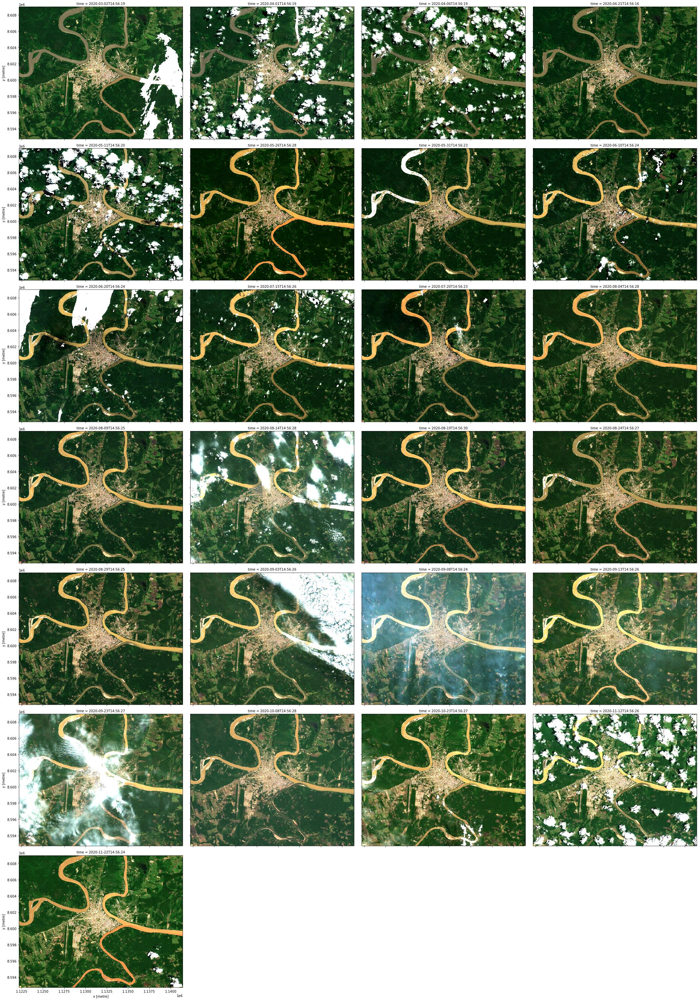

In [7]:
rgb(ds, bands=["B04", "B03", "B02"], col="time")

### plot one image in RGB (true color)

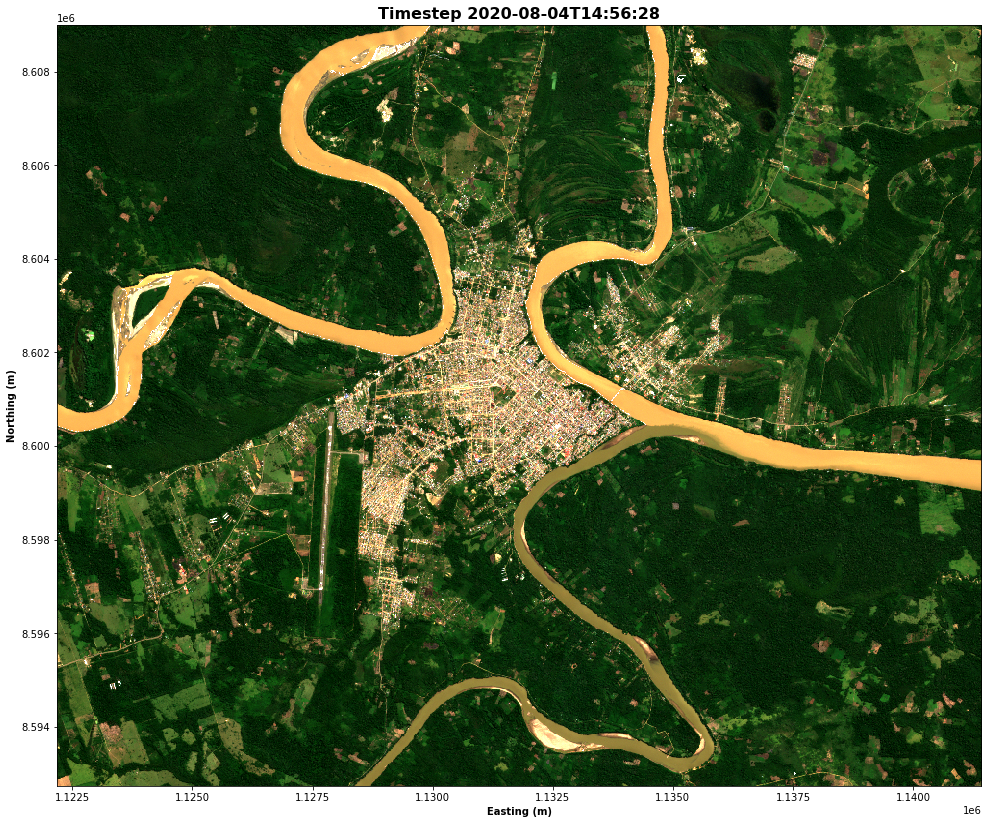

In [9]:
# Set the time step to view
time_step = 11

# Set the band combination to plot
bands = ["B04", "B03", "B02"]

# Generate the image by running the rgb function
rgb(ds, bands=bands, index=time_step, size=14)

# Format the time stamp for use as the plot title
time_string = str(ds.time.isel(time=time_step).values).split('.')[0]

# Set the title and axis labels
ax = plt.gca()
ax.set_title(f"Timestep {time_string}", fontweight='bold', fontsize=16)
ax.set_xlabel('Easting (m)', fontweight='bold')
ax.set_ylabel('Northing (m)', fontweight='bold')

# Display the plot
# plt.axis("off")
plt.show()

### plot the same image in false color (SWIR1, NIR, G)

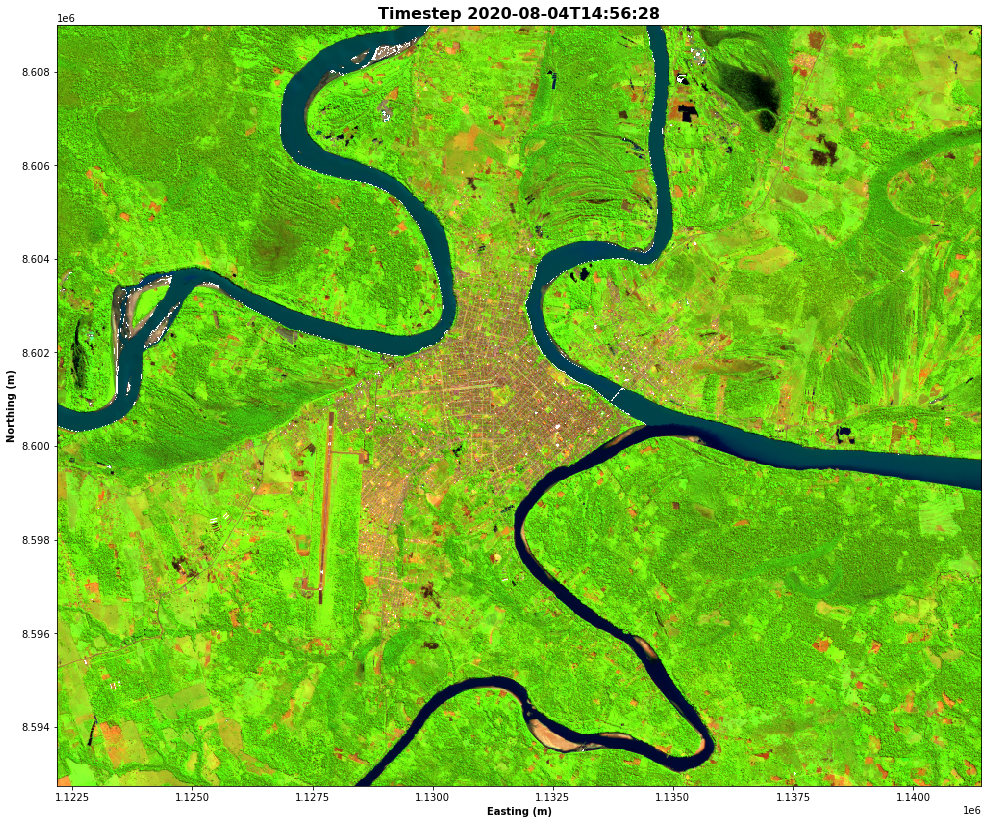

In [10]:
# Set the band combination to plot
bands = ["B11", "B08", "B03"]

# Generate the image by running the rgb function
rgb(ds, bands=bands, index=time_step, size=14)

# Format the time stamp for use as the plot title
time_string = str(ds.time.isel(time=time_step).values).split('.')[0]

# Set the title and axis labels
ax = plt.gca()
ax.set_title(f"Timestep {time_string}", fontweight='bold', fontsize=16)
ax.set_xlabel('Easting (m)', fontweight='bold')
ax.set_ylabel('Northing (m)', fontweight='bold')

# Display the plot
# plt.axis("off")
plt.show()

### Set variables for individual bands

In [11]:
blue = ds.B02
green = ds.B03
red = ds.B04
r_edge = ds.B05
nir = ds.B08
swir1 = ds.B11

### Analysis and Visualization

### NDVI
$$
\begin{aligned}
\text{NDVI} & = \frac{(\text{NIR} - \text{Red})}{(\text{NIR} + \text{Red})} \\
\end{aligned}
$$

In [22]:
band_diff = nir - red
band_sum = nir + red

# Calculate NDVI
ndvi = band_diff / band_sum

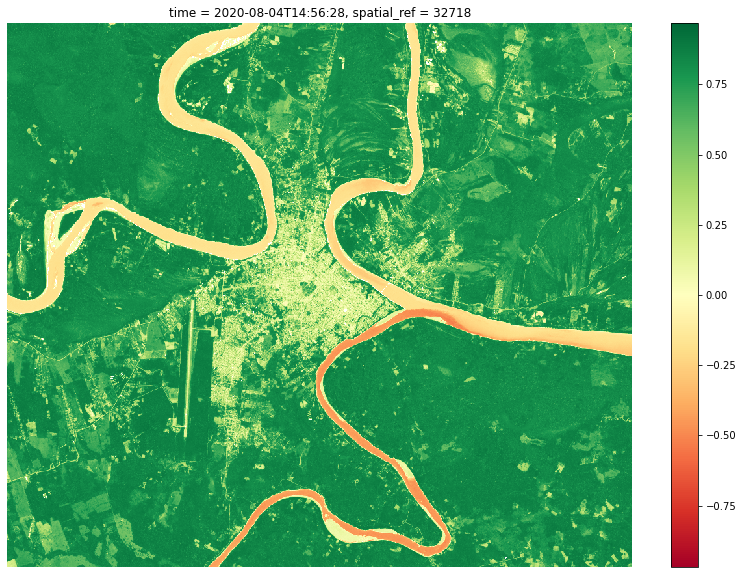

In [13]:
# plot NDVI
plt.figure(figsize=(14, 10))
ndvi.isel(time=time_step).plot(cmap="RdYlGn")
plt.axis("off")
plt.show()

### NDWI
$$
\begin{aligned}
\text{NDWI} & = \frac{(\text{Green} - \text{NIR})}{(\text{Green} + \text{NIR})} \\
\end{aligned}
$$

In [14]:
ndwi_numerator = green - nir
ndwi_denominator = green + nir

# Calculate NDWI
ndwi = ndwi_numerator / ndwi_denominator

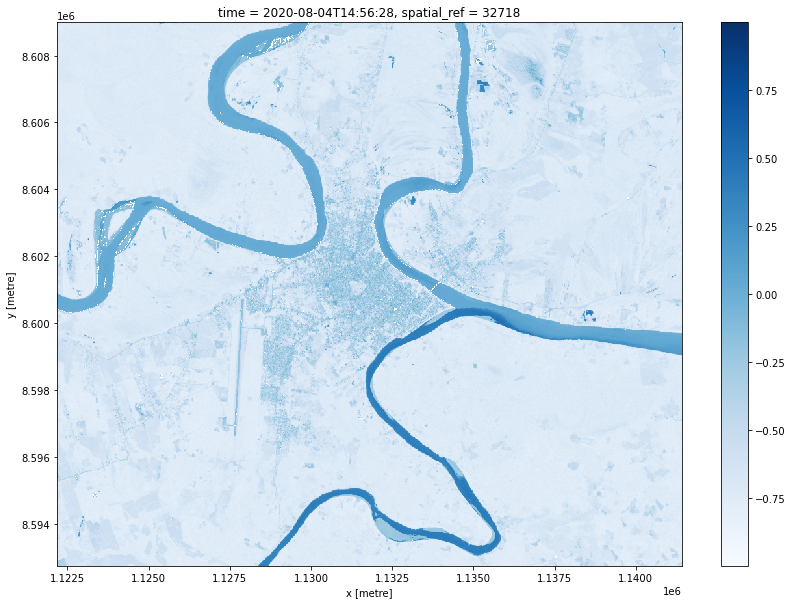

In [15]:
# Plot NDWI
plt.figure(figsize=(14, 10))
ndwi.isel(time=time_step).plot(cmap="Blues")
plt.show()

### MNDWI
$$
\begin{aligned}
\text{MNDWI} & = \frac{(\text{Green} - \text{SWIR})}{(\text{Green} + \text{SWIR})} \\
\end{aligned}
$$

In [16]:
mndwi_numerator = green - swir1
mndwi_denominator = green + swir1

# Calculate MNDVI
mndwi = mndwi_numerator / mndwi_denominator

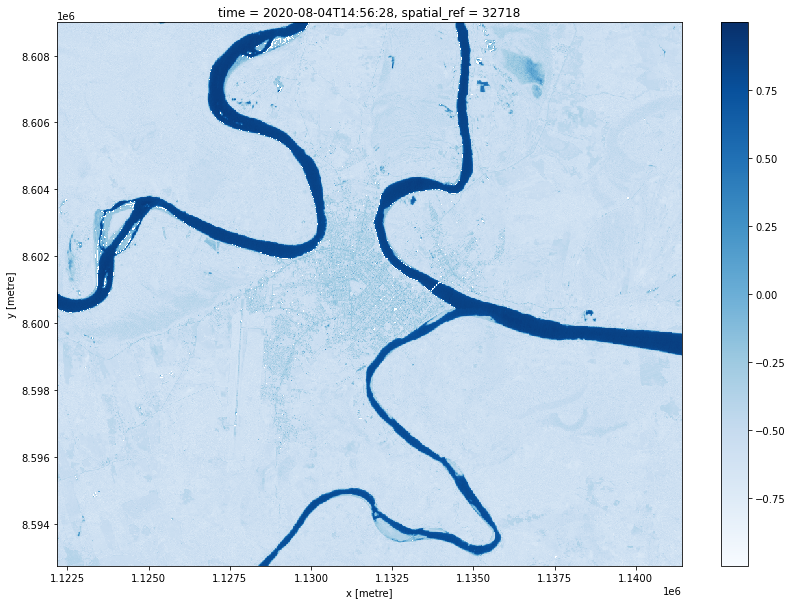

In [17]:
# Plot MNDWI
plt.figure(figsize=(14, 10))
mndwi.isel(time=time_step).plot(cmap="Blues")
plt.show()

### NDCI
$$
\begin{aligned}
\text{NDCI} & = \frac{(\text{Red Edge} - \text{Red})}{(\text{Red Edge} + \text{Red})} \\
\end{aligned}
$$

In [18]:
ndci_numerator = r_edge - red
ndci_denominator = r_edge + red

# Calculate NDCI
ndci = ndci_numerator / ndci_denominator

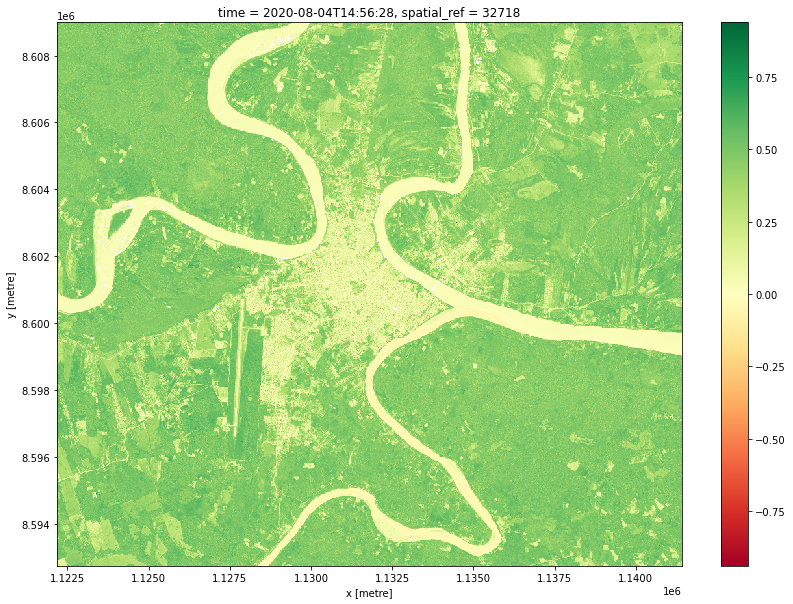

In [19]:
# Set the NDCI time step to view
plt.figure(figsize=(14, 10))
ndci.isel(time=time_step).plot(cmap="RdYlGn")
plt.show()

### Export all bands in GeoTIFF

In [ ]:
# Export red band
filename = "pto_maldonado_red.tiff"

write_cog(geo_im=red.isel(time=time_step), fname=filename, overwrite=True)

In [ ]:
# Export green band
filename = "pto_maldonado_green.tiff"

write_cog(geo_im=green.isel(time=time_step), fname=filename, overwrite=True)

In [ ]:
# Export blue band
filename = "pto_maldonado_blue.tiff"

write_cog(geo_im=blue.isel(time=time_step), fname=filename, overwrite=True)

In [ ]:
# Export nir band
filename = "pto_maldonado_nir.tiff"

write_cog(geo_im=nir.isel(time=time_step), fname=filename, overwrite=True)

In [ ]:
# Export swir1 band
filename = "pto_maldonado_swir1.tiff"

write_cog(geo_im=swir1.isel(time=time_step), fname=filename, overwrite=True)

In [ ]:
# Export red edge band
filename = "pto_maldonado_edge.tiff"

write_cog(geo_im=r_edge.isel(time=time_step), fname=filename, overwrite=True)

### Exporting analyzed data

In [ ]:
# Export NDVI
filename = "pto_maldonado_ndvi.tiff"

write_cog(geo_im=ndvi.isel(time=time_step), fname=filename, overwrite=True)

In [ ]:
# Export NDWI
filename = "pto_maldonado_ndwi.tiff"

write_cog(geo_im=ndwi.isel(time=time_step), fname=filename, overwrite=True)

In [ ]:
# Export MNDWI
filename = "pto_maldonado_mndwi.tiff"

write_cog(geo_im=mndwi.isel(time=time_step), fname=filename, overwrite=True)

In [ ]:
# Export NDCI
filename = "pto_maldonado_ndci.tiff"

write_cog(geo_im=ndci.isel(time=time_step), fname=filename, overwrite=True)

### Export RGB image (jpg)

In [ ]:
# Set the band combination to plot
bands = ["B04", "B03", "B02"]

# Generate the image by running the rgb function
rgb(ds, bands=bands, index=time_step, size=14)

# Display and save the image
plt.axis("off")
plt.savefig(r"C:\Downloads\pto_maldonado_rgb.jpg", bbox_inches='tight', pad_inches=0)
plt.show()

### Export false color image (jpg)

In [ ]:
# Set the band combination to plot
bands = ["B11", "B08", "B03"]

# Generate the image by running the rgb function
rgb(ds, bands=bands, index=time_step, size=14)

# Display and save the image
plt.axis("off")
plt.savefig(r"C:\Downloads\pto_maldonado_false_color.jpg", bbox_inches='tight', pad_inches=0)
plt.show()